In [1]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]="7"  # last GPU

In [2]:
from datetime import datetime
import os

import numpy as np
import torch
from IPython.display import display
import nvdiffrast.torch as dr
from PIL import Image

In [3]:
image_fn = 'assets/monalisa.png'
h, w = 256, 256
n_triangles = 200
base_lr = 0.03
report_iterations = 10
n_iterations = 2000

In [4]:
def to_pil_img(img):
    return Image.fromarray((img[0].clip(0,1).detach().cpu().numpy()*255).astype('uint8'))

def show(img):
    display(to_pil_img(img))

In [5]:
target = Image.open(image_fn).resize((h, w)).convert('RGB')
target = np.asarray(target)
target = torch.from_numpy(target.astype('f') / 255).cuda()[None, ...]

In [6]:
glctx = dr.RasterizeGLContext()

In [7]:
verts = (torch.rand(n_triangles, 3, 2) * 2 - 1).cuda()
verts.requires_grad = True
color = torch.rand(n_triangles, 4).float().cuda()
color.requires_grad = True

In [8]:
faces = torch.arange(n_triangles * 3).reshape(-1, 3).int().cuda()
def combine_layers(out, bg_noise=0.05):
    canvas = torch.ones_like(out[0:1,:,:,0:3])
    canvas = canvas + torch.randn_like(out[0:1,:,:,0:3]) * bg_noise
    for i in range(0, n_triangles):
        alpha = out[i:i+1, ..., 3:4]
        #if i > 150:
        alpha = alpha * 0.1
        draw_color = out[i:i+1, ..., 0:3]
        canvas = canvas * (1 - alpha) + alpha * draw_color
    return canvas

In [9]:
def render(v, c, combine_layers_kwargs={}):
    verts_norm = v 
    color_norm = c 
    m_ones = -torch.ones(n_triangles, 3, 1).cuda().float()
    ones = torch.ones(n_triangles, 3, 1).cuda().float()
    verts_in = torch.cat([verts_norm, m_ones, ones], dim =2) # [..., None, :]
    colors = color_norm[:, None, :].repeat(1, 3, 1)
    rast, _ = dr.rasterize(glctx, verts_in, faces, resolution=[h, w], grad_db=True)
    out_inter, _ = dr.interpolate(colors, rast, faces)
    out_layers = dr.antialias(out_inter, rast, verts_in, faces, pos_gradient_boost=1)
    out = combine_layers(out_layers, **combine_layers_kwargs)
    return out

In [10]:
class OptimRateScheduler(object):
    def __init__(self, total_iterations):
        self.total_iterations = total_iterations
        self.ramp_up_to = 1 / 20
        self.ramp_down_from = 3 / 4
    def get_lr_scale(self, c_iter):
        t = c_iter / self.total_iterations
        lr_ramp = min(1.0, (1.0 - t) / 0.25)
        lr_ramp = 0.5 - 0.5 * np.cos(lr_ramp * np.pi)
        lr_ramp = lr_ramp * min(1.0, t / 0.05)
        return lr_ramp
    def get_noise_scale(self, c_iter):
        t = c_iter / self.total_iterations
        if t > self.ramp_down_from:
            return 0
        else:
            return ((self.ramp_down_from - t) / self.ramp_down_from)**2

In [11]:
optim = torch.optim.Adam([verts, color], lr = base_lr)
ors = OptimRateScheduler(total_iterations=n_iterations)

In [12]:
def save_as_gif(fn, imgs, fps=12):
    img, *imgs = imgs
    with open(fn, 'wb') as fp_out:
        img.save(fp=fp_out, format='GIF', append_images=imgs,
             save_all=True, duration=int(1000./fps), loop=0)
        
def save_as_frames(fn, imgs, overwrite=True):
    # save to folder `fn` with sequenced filenames
    os.makedirs(fn, exist_ok=True)
    for i, img in enumerate(imgs):
        this_fn = os.path.join(fn, f'{i:08}.png')
        if overwrite or not os.path.exists(this_fn):
            save_as_png(this_fn, img)

def save_as_png(fn, img):
    if not fn.endswith('.png'):
        fn = f'{fn}.png'
    img.save(fn)
            
def save_info_list(fn, info_list):
    with open(fn, 'w') as fout:
        list(map(lambda r: print(r, file=fout), info_list))

[2021-08-31 10:32:28.063082]   Iteration 10, lr 0.0026999999999999993, loss 0.17369958758354187 loss (without noise) 0.17269563674926758


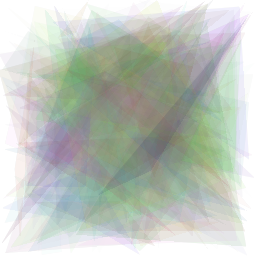

[2021-08-31 10:32:32.753305]   Iteration 20, lr 0.005699999999999999, loss 0.14460985362529755 loss (without noise) 0.1430341899394989


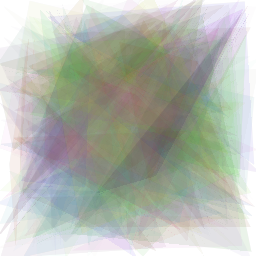

[2021-08-31 10:32:37.397729]   Iteration 30, lr 0.0087, loss 0.0994337722659111 loss (without noise) 0.09924817085266113


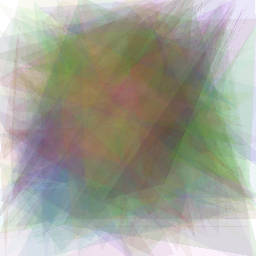

[2021-08-31 10:32:42.076761]   Iteration 40, lr 0.011699999999999999, loss 0.06044470891356468 loss (without noise) 0.05984547734260559


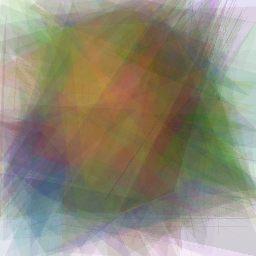

[2021-08-31 10:32:46.824395]   Iteration 50, lr 0.0147, loss 0.03548883646726608 loss (without noise) 0.03509543463587761


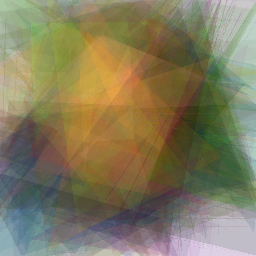

[2021-08-31 10:32:51.581824]   Iteration 60, lr 0.017699999999999997, loss 0.022019004449248314 loss (without noise) 0.021759621798992157


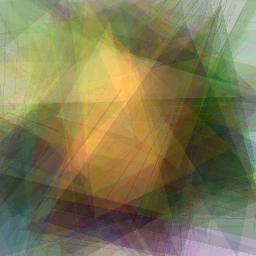

[2021-08-31 10:32:56.377770]   Iteration 70, lr 0.0207, loss 0.015842372551560402 loss (without noise) 0.015601377002894878


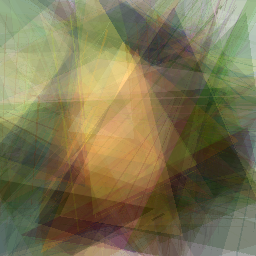

[2021-08-31 10:33:01.204811]   Iteration 80, lr 0.023699999999999995, loss 0.012770568951964378 loss (without noise) 0.01262082438915968


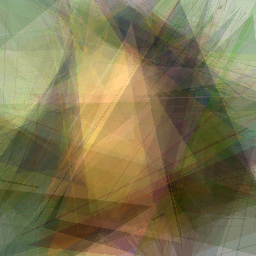

[2021-08-31 10:33:06.059857]   Iteration 90, lr 0.026699999999999995, loss 0.011087825521826744 loss (without noise) 0.01087559200823307


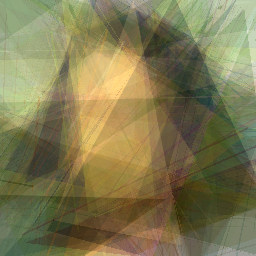

[2021-08-31 10:33:10.946566]   Iteration 100, lr 0.029699999999999997, loss 0.00962046068161726 loss (without noise) 0.009440342895686626


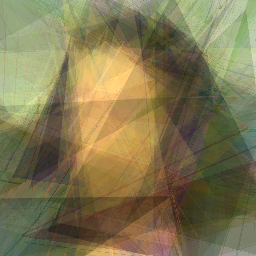

[2021-08-31 10:33:15.865565]   Iteration 110, lr 0.03, loss 0.008722053840756416 loss (without noise) 0.008563744835555553


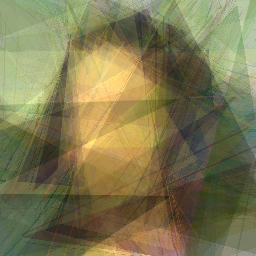

[2021-08-31 10:33:20.814849]   Iteration 120, lr 0.03, loss 0.00802835077047348 loss (without noise) 0.007875900715589523


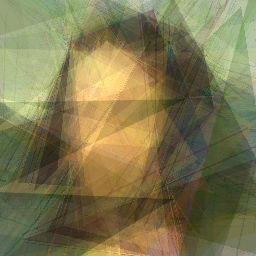

[2021-08-31 10:33:25.787930]   Iteration 130, lr 0.03, loss 0.007654043845832348 loss (without noise) 0.007481932640075684


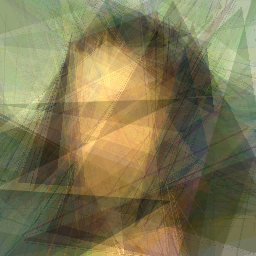

[2021-08-31 10:33:30.804209]   Iteration 140, lr 0.03, loss 0.007440273649990559 loss (without noise) 0.007301338016986847


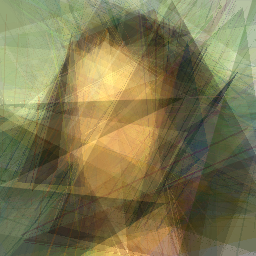

[2021-08-31 10:33:35.857258]   Iteration 150, lr 0.03, loss 0.007088152226060629 loss (without noise) 0.006962142884731293


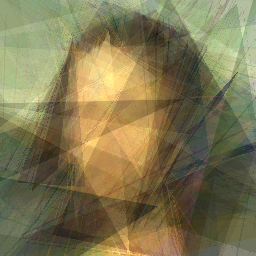

[2021-08-31 10:33:40.912228]   Iteration 160, lr 0.03, loss 0.0067929429933428764 loss (without noise) 0.006648232229053974


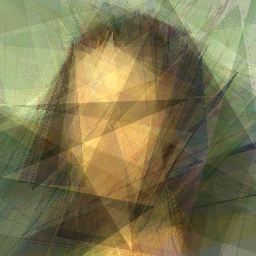

[2021-08-31 10:33:45.982730]   Iteration 170, lr 0.03, loss 0.006565380841493607 loss (without noise) 0.0064326683059334755


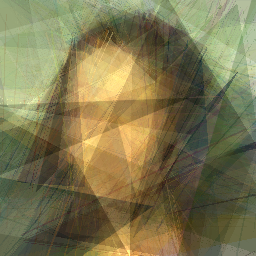

[2021-08-31 10:33:51.072679]   Iteration 180, lr 0.03, loss 0.006336949300020933 loss (without noise) 0.0062117548659443855


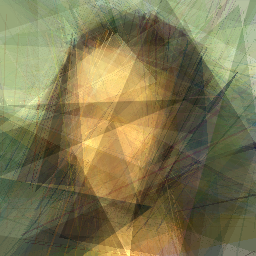

[2021-08-31 10:33:56.201297]   Iteration 190, lr 0.03, loss 0.006392253562808037 loss (without noise) 0.006218031980097294


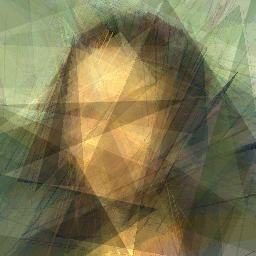

[2021-08-31 10:34:01.362975]   Iteration 200, lr 0.03, loss 0.0062150112353265285 loss (without noise) 0.0060538253746926785


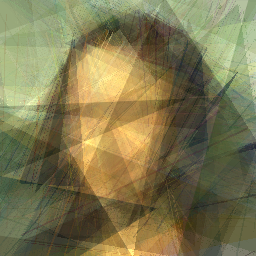

[2021-08-31 10:34:06.542119]   Iteration 210, lr 0.03, loss 0.005844691302627325 loss (without noise) 0.005721482913941145


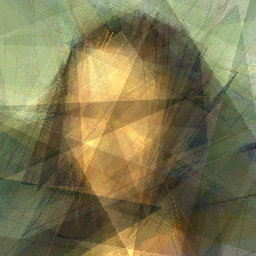

[2021-08-31 10:34:11.741166]   Iteration 220, lr 0.03, loss 0.005654766224324703 loss (without noise) 0.0055214157328009605


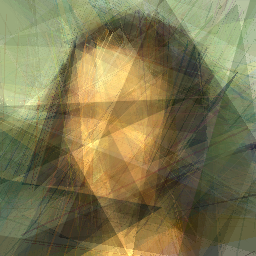

[2021-08-31 10:34:16.977743]   Iteration 230, lr 0.03, loss 0.005552390124648809 loss (without noise) 0.005441212095320225


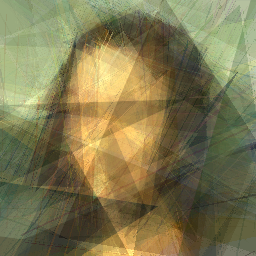

[2021-08-31 10:34:22.238970]   Iteration 240, lr 0.03, loss 0.005506299436092377 loss (without noise) 0.0053930580615997314


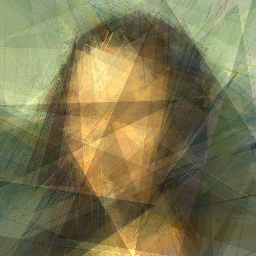

[2021-08-31 10:34:27.542540]   Iteration 250, lr 0.03, loss 0.005376964341849089 loss (without noise) 0.005261510610580444


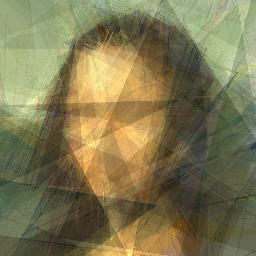

[2021-08-31 10:34:32.851664]   Iteration 260, lr 0.03, loss 0.005376267246901989 loss (without noise) 0.005281216464936733


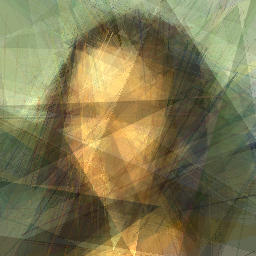

[2021-08-31 10:34:38.204378]   Iteration 270, lr 0.03, loss 0.0052817813120782375 loss (without noise) 0.005151013843715191


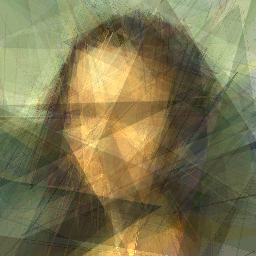

[2021-08-31 10:34:43.563478]   Iteration 280, lr 0.03, loss 0.005178432445973158 loss (without noise) 0.005072308704257011


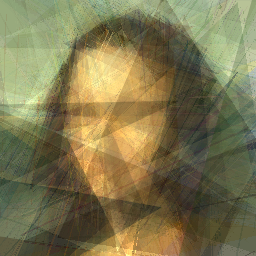

[2021-08-31 10:34:48.970775]   Iteration 290, lr 0.03, loss 0.005295587237924337 loss (without noise) 0.005191663280129433


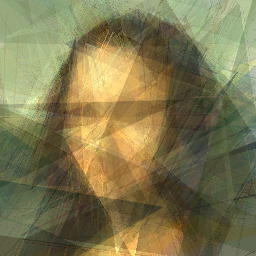

[2021-08-31 10:34:54.420355]   Iteration 300, lr 0.03, loss 0.0051901633851230145 loss (without noise) 0.005092063453048468


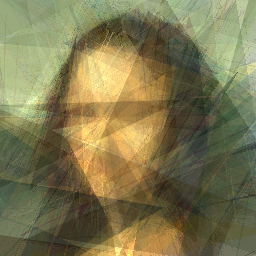

[2021-08-31 10:34:59.906210]   Iteration 310, lr 0.03, loss 0.005144211929291487 loss (without noise) 0.005028530489653349


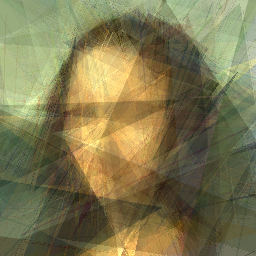

[2021-08-31 10:35:05.435865]   Iteration 320, lr 0.03, loss 0.005034416913986206 loss (without noise) 0.004932045936584473


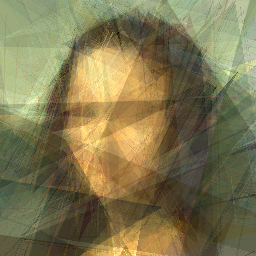

[2021-08-31 10:35:10.977661]   Iteration 330, lr 0.03, loss 0.004887407645583153 loss (without noise) 0.004804390016943216


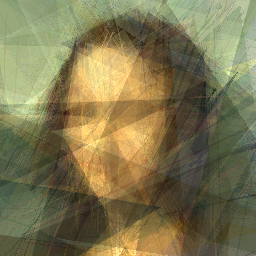

[2021-08-31 10:35:16.517350]   Iteration 340, lr 0.03, loss 0.004813689272850752 loss (without noise) 0.0047171758487820625


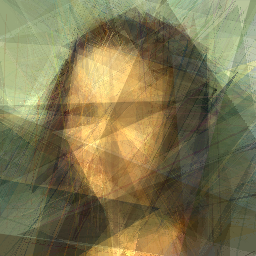

[2021-08-31 10:35:22.062321]   Iteration 350, lr 0.03, loss 0.004757789894938469 loss (without noise) 0.0046599796041846275


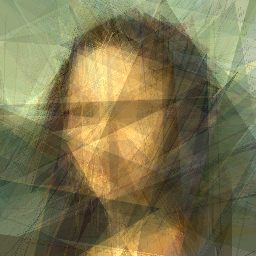

[2021-08-31 10:35:27.638215]   Iteration 360, lr 0.03, loss 0.004671982489526272 loss (without noise) 0.004593725316226482


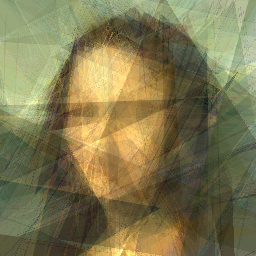

[2021-08-31 10:35:33.257627]   Iteration 370, lr 0.03, loss 0.004727941006422043 loss (without noise) 0.004654057789593935


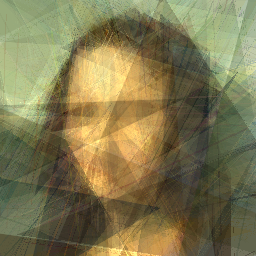

[2021-08-31 10:35:38.931327]   Iteration 380, lr 0.03, loss 0.004693778231739998 loss (without noise) 0.004589659161865711


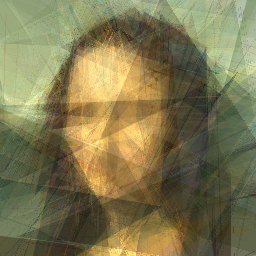

[2021-08-31 10:35:44.604710]   Iteration 390, lr 0.03, loss 0.004676159471273422 loss (without noise) 0.0045791673474013805


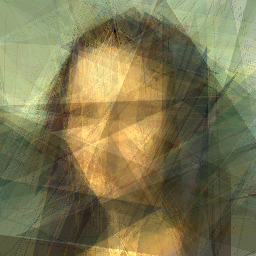

[2021-08-31 10:35:50.310717]   Iteration 400, lr 0.03, loss 0.0046259695664048195 loss (without noise) 0.004536975175142288


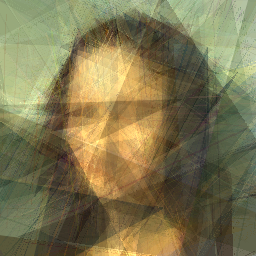

[2021-08-31 10:35:56.037560]   Iteration 410, lr 0.03, loss 0.004611397162079811 loss (without noise) 0.004509287420660257


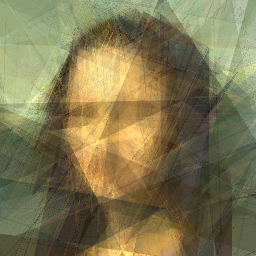

[2021-08-31 10:36:01.809003]   Iteration 420, lr 0.03, loss 0.0046015712432563305 loss (without noise) 0.004518713336437941


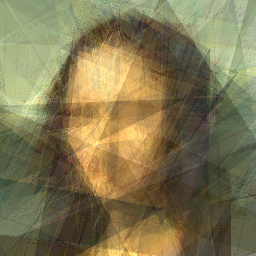

[2021-08-31 10:36:07.616992]   Iteration 430, lr 0.03, loss 0.004570258315652609 loss (without noise) 0.004504813812673092


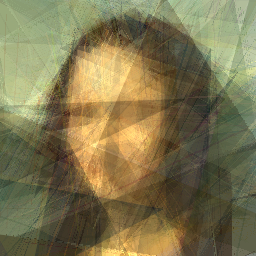

[2021-08-31 10:36:13.444754]   Iteration 440, lr 0.03, loss 0.004659691825509071 loss (without noise) 0.0045927418395876884


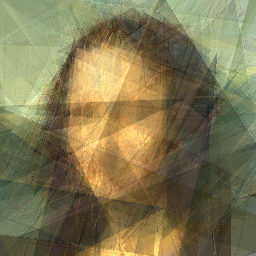

[2021-08-31 10:36:19.322170]   Iteration 450, lr 0.03, loss 0.004745760466903448 loss (without noise) 0.004679535981267691


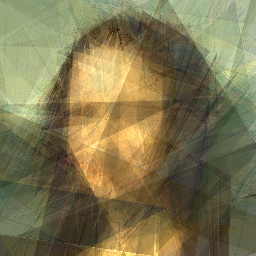

[2021-08-31 10:36:25.208027]   Iteration 460, lr 0.03, loss 0.0047362251207232475 loss (without noise) 0.004672779701650143


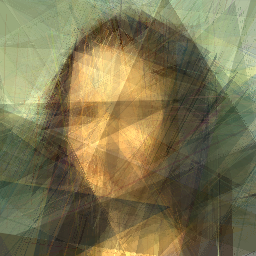

[2021-08-31 10:36:31.096639]   Iteration 470, lr 0.03, loss 0.004613674245774746 loss (without noise) 0.004547475837171078


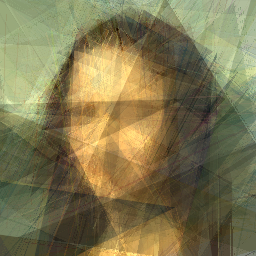

[2021-08-31 10:36:37.022278]   Iteration 480, lr 0.03, loss 0.004502476193010807 loss (without noise) 0.004441216588020325


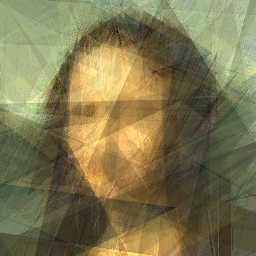

[2021-08-31 10:36:42.975715]   Iteration 490, lr 0.03, loss 0.0043945880606770515 loss (without noise) 0.004337560385465622


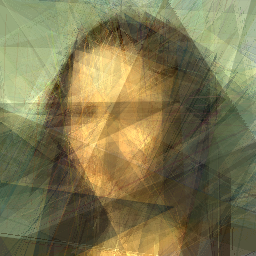

[2021-08-31 10:36:48.961425]   Iteration 500, lr 0.03, loss 0.004317949991673231 loss (without noise) 0.004254618659615517


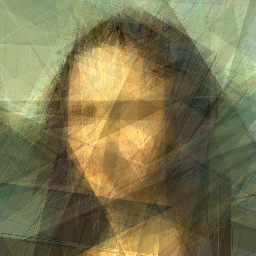

[2021-08-31 10:36:54.986736]   Iteration 510, lr 0.03, loss 0.004333571530878544 loss (without noise) 0.0042680399492383


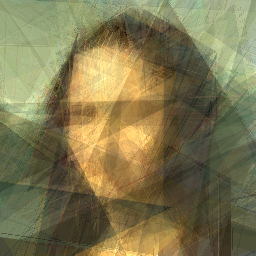

[2021-08-31 10:37:01.015041]   Iteration 520, lr 0.03, loss 0.004320218693464994 loss (without noise) 0.00427037151530385


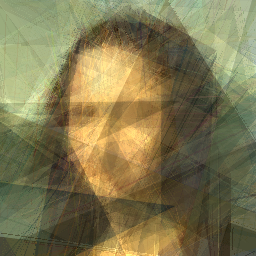

[2021-08-31 10:37:07.059321]   Iteration 530, lr 0.03, loss 0.004317862447351217 loss (without noise) 0.004250142257660627


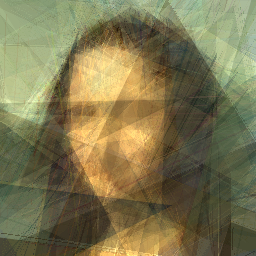

[2021-08-31 10:37:13.140898]   Iteration 540, lr 0.03, loss 0.004258958622813225 loss (without noise) 0.004200918599963188


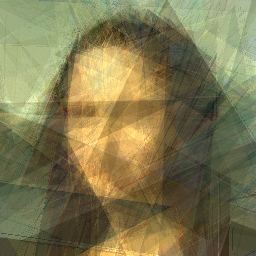

[2021-08-31 10:37:19.238251]   Iteration 550, lr 0.03, loss 0.004286298528313637 loss (without noise) 0.004239298403263092


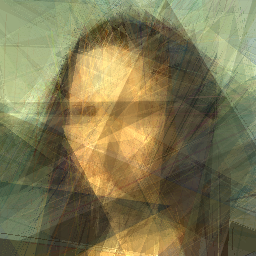

[2021-08-31 10:37:25.390308]   Iteration 560, lr 0.03, loss 0.004228873178362846 loss (without noise) 0.004177608992904425


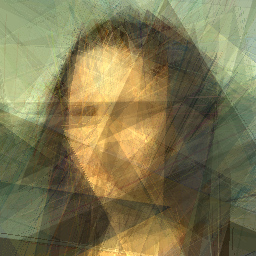

[2021-08-31 10:37:31.550651]   Iteration 570, lr 0.03, loss 0.004104427993297577 loss (without noise) 0.004051062744110823


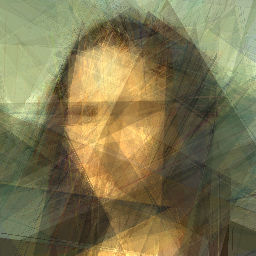

[2021-08-31 10:37:37.786458]   Iteration 580, lr 0.03, loss 0.004127326421439648 loss (without noise) 0.004075275734066963


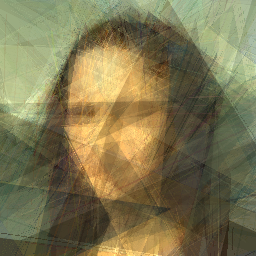

[2021-08-31 10:37:44.025336]   Iteration 590, lr 0.03, loss 0.004154788330197334 loss (without noise) 0.004108946770429611


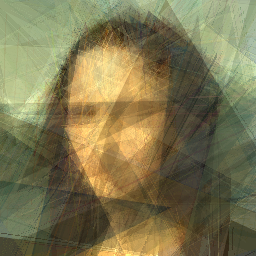

[2021-08-31 10:37:50.353294]   Iteration 600, lr 0.03, loss 0.004155698232352734 loss (without noise) 0.004107221029698849


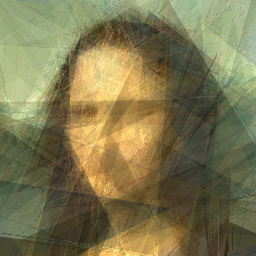

[2021-08-31 10:37:56.724071]   Iteration 610, lr 0.03, loss 0.004084487445652485 loss (without noise) 0.004048414994031191


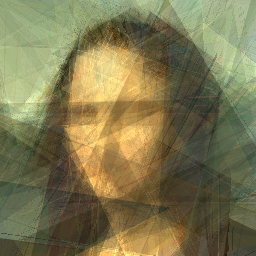

[2021-08-31 10:38:03.116620]   Iteration 620, lr 0.03, loss 0.0040608677081763744 loss (without noise) 0.004022054374217987


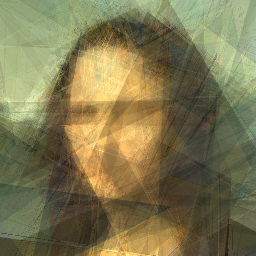

[2021-08-31 10:38:09.479918]   Iteration 630, lr 0.03, loss 0.004094439093023539 loss (without noise) 0.0040500410832464695


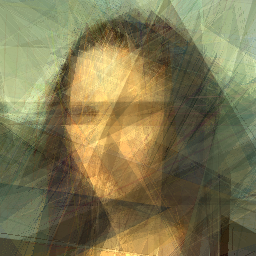

[2021-08-31 10:38:15.834830]   Iteration 640, lr 0.03, loss 0.004023335874080658 loss (without noise) 0.003991314209997654


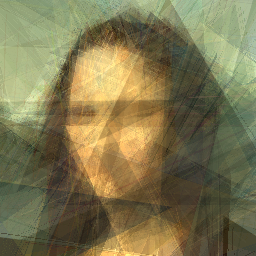

[2021-08-31 10:38:22.238471]   Iteration 650, lr 0.03, loss 0.004001498222351074 loss (without noise) 0.00395888090133667


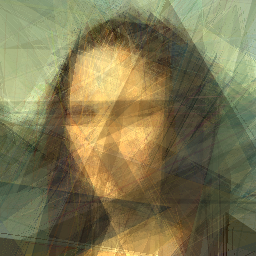

[2021-08-31 10:38:28.651268]   Iteration 660, lr 0.03, loss 0.0039441827684640884 loss (without noise) 0.003916183486580849


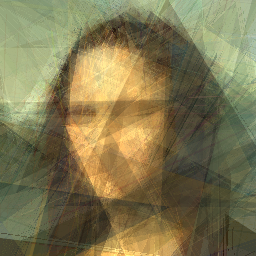

[2021-08-31 10:38:35.143152]   Iteration 670, lr 0.03, loss 0.003935768269002438 loss (without noise) 0.0039016511291265488


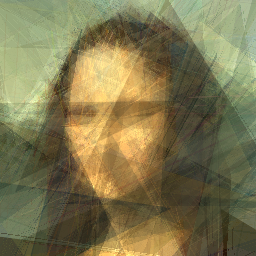

[2021-08-31 10:38:41.640218]   Iteration 680, lr 0.03, loss 0.003921612165868282 loss (without noise) 0.0038879066705703735


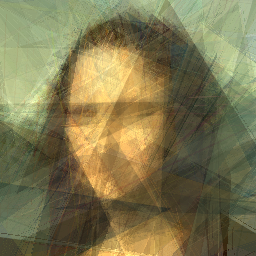

[2021-08-31 10:38:48.169433]   Iteration 690, lr 0.03, loss 0.0038917013444006443 loss (without noise) 0.0038555513601750135


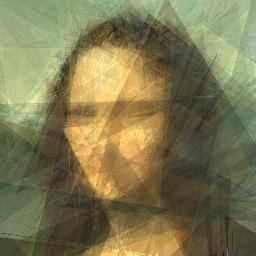

[2021-08-31 10:38:54.741740]   Iteration 700, lr 0.03, loss 0.00381458830088377 loss (without noise) 0.0037811831571161747


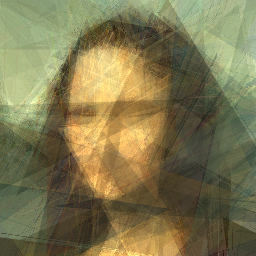

[2021-08-31 10:39:01.329405]   Iteration 710, lr 0.03, loss 0.0037630058359354734 loss (without noise) 0.003725918708369136


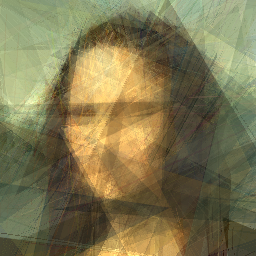

[2021-08-31 10:39:07.943816]   Iteration 720, lr 0.03, loss 0.003777555888518691 loss (without noise) 0.00374084385111928


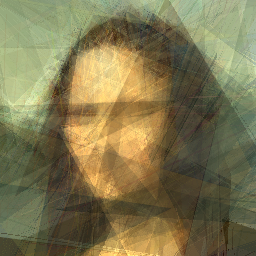

[2021-08-31 10:39:14.581932]   Iteration 730, lr 0.03, loss 0.0037705139257013798 loss (without noise) 0.00373147614300251


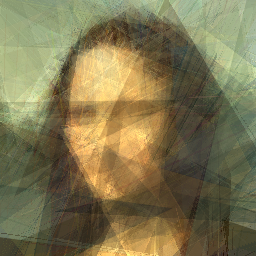

[2021-08-31 10:39:21.273846]   Iteration 740, lr 0.03, loss 0.00375065254047513 loss (without noise) 0.0037181524094194174


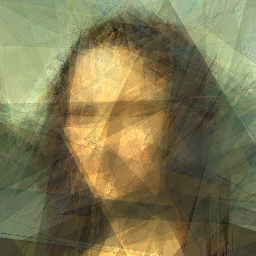

[2021-08-31 10:39:27.986162]   Iteration 750, lr 0.03, loss 0.003731731791049242 loss (without noise) 0.0036960754077881575


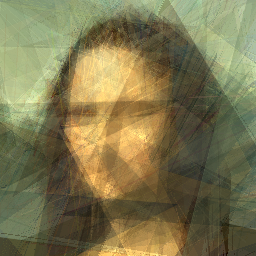

[2021-08-31 10:39:34.723169]   Iteration 760, lr 0.03, loss 0.003769818227738142 loss (without noise) 0.003737509250640869


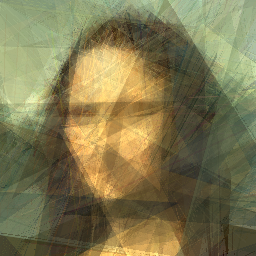

[2021-08-31 10:39:41.508479]   Iteration 770, lr 0.03, loss 0.003691490739583969 loss (without noise) 0.0036611908581107855


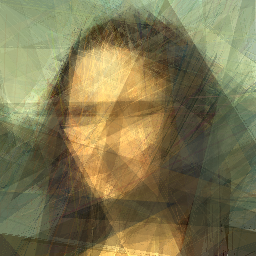

[2021-08-31 10:39:48.254180]   Iteration 780, lr 0.03, loss 0.0036695324815809727 loss (without noise) 0.003645156044512987


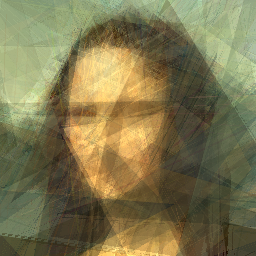

[2021-08-31 10:39:55.057477]   Iteration 790, lr 0.03, loss 0.003652020823210478 loss (without noise) 0.003629602026194334


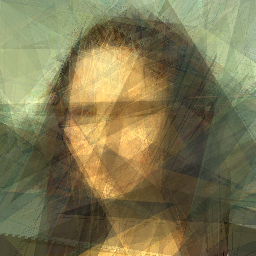

[2021-08-31 10:40:01.902354]   Iteration 800, lr 0.03, loss 0.0036805872805416584 loss (without noise) 0.003647669218480587


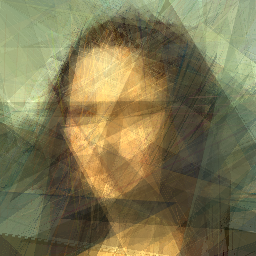

[2021-08-31 10:40:08.782014]   Iteration 810, lr 0.03, loss 0.0036639857571572065 loss (without noise) 0.0036341219674795866


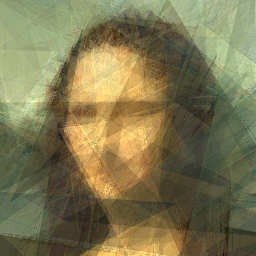

[2021-08-31 10:40:15.675863]   Iteration 820, lr 0.03, loss 0.0036408293526619673 loss (without noise) 0.0036170422099530697


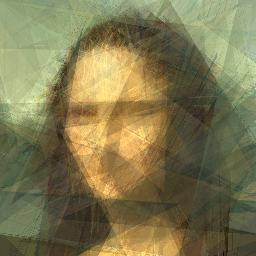

[2021-08-31 10:40:22.589733]   Iteration 830, lr 0.03, loss 0.0036272897850722075 loss (without noise) 0.0036023377906531096


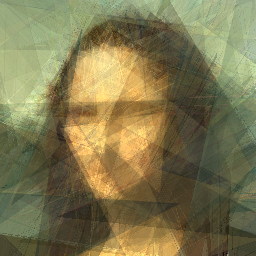

[2021-08-31 10:40:29.550607]   Iteration 840, lr 0.03, loss 0.0035864580422639847 loss (without noise) 0.0035600520204752684


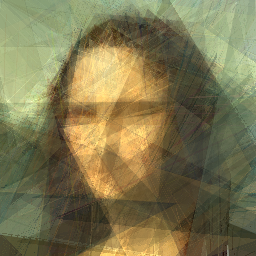

[2021-08-31 10:40:36.817012]   Iteration 850, lr 0.03, loss 0.003595953341573477 loss (without noise) 0.003565485356375575


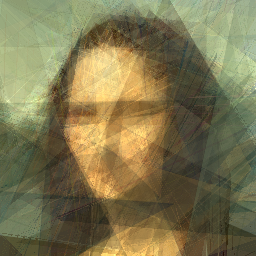

[2021-08-31 10:40:44.047748]   Iteration 860, lr 0.03, loss 0.003573750611394644 loss (without noise) 0.003551672212779522


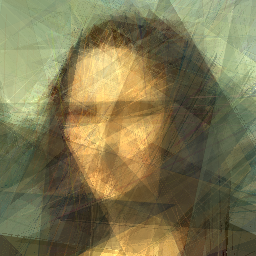

[2021-08-31 10:40:51.152419]   Iteration 870, lr 0.03, loss 0.0035919768270105124 loss (without noise) 0.003570000408217311


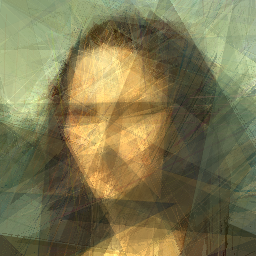

[2021-08-31 10:40:58.289000]   Iteration 880, lr 0.03, loss 0.003527503227815032 loss (without noise) 0.0035098097287118435


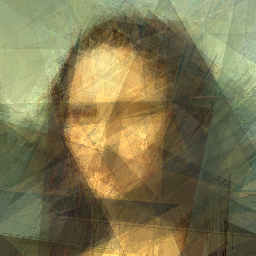

[2021-08-31 10:41:05.425461]   Iteration 890, lr 0.03, loss 0.003533234354108572 loss (without noise) 0.0035106311552226543


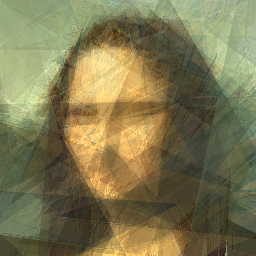

[2021-08-31 10:41:12.614422]   Iteration 900, lr 0.03, loss 0.003593877423554659 loss (without noise) 0.003573065623641014


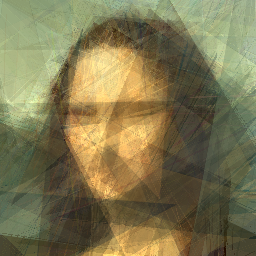

[2021-08-31 10:41:19.766649]   Iteration 910, lr 0.03, loss 0.0035901665687561035 loss (without noise) 0.0035684159956872463


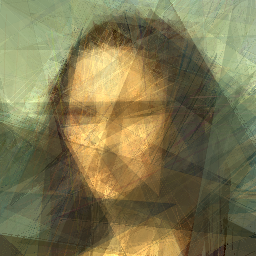

[2021-08-31 10:41:27.035547]   Iteration 920, lr 0.03, loss 0.0036125590559095144 loss (without noise) 0.003587764222174883


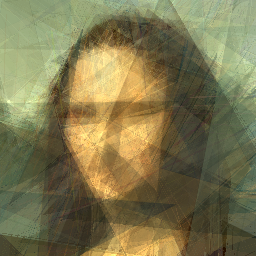

[2021-08-31 10:41:34.359092]   Iteration 930, lr 0.03, loss 0.0035765799693763256 loss (without noise) 0.0035567255690693855


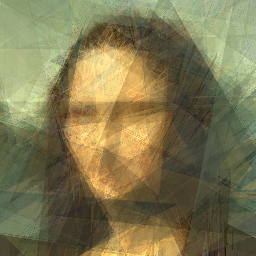

[2021-08-31 10:41:41.718970]   Iteration 940, lr 0.03, loss 0.0035931419115513563 loss (without noise) 0.0035686264745891094


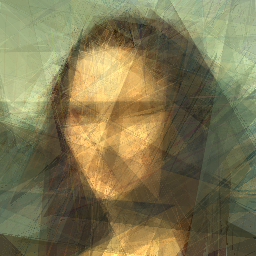

[2021-08-31 10:41:49.213976]   Iteration 950, lr 0.03, loss 0.0035788766108453274 loss (without noise) 0.0035618736874312162


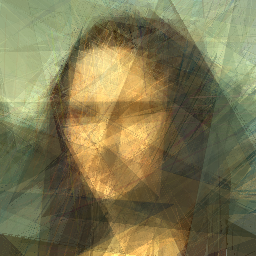

[2021-08-31 10:41:56.519856]   Iteration 960, lr 0.03, loss 0.0035610951017588377 loss (without noise) 0.0035442800726741552


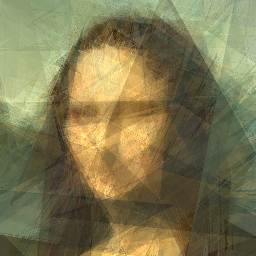

[2021-08-31 10:42:03.885578]   Iteration 970, lr 0.03, loss 0.0036023096181452274 loss (without noise) 0.0035826002713292837


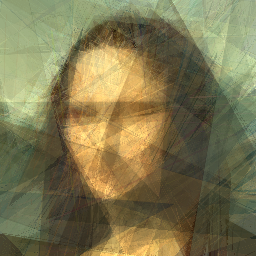

[2021-08-31 10:42:11.243615]   Iteration 980, lr 0.03, loss 0.0036245768424123526 loss (without noise) 0.0036080197896808386


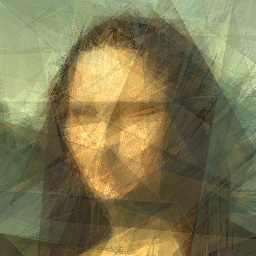

[2021-08-31 10:42:18.685780]   Iteration 990, lr 0.03, loss 0.0036046537570655346 loss (without noise) 0.003587676677852869


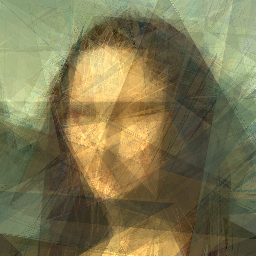

[2021-08-31 10:42:26.155563]   Iteration 1000, lr 0.03, loss 0.0036035971716046333 loss (without noise) 0.0035837243776768446


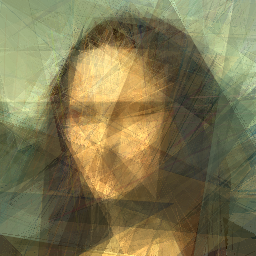

[2021-08-31 10:42:33.647666]   Iteration 1010, lr 0.03, loss 0.0035710125230252743 loss (without noise) 0.0035556366201490164


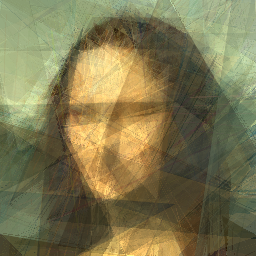

[2021-08-31 10:42:41.153040]   Iteration 1020, lr 0.03, loss 0.0035792174749076366 loss (without noise) 0.0035634110681712627


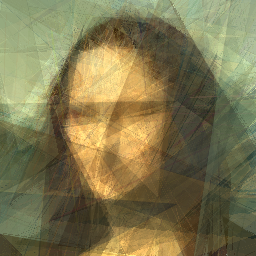

[2021-08-31 10:42:48.721591]   Iteration 1030, lr 0.03, loss 0.0036413604393601418 loss (without noise) 0.003626784309744835


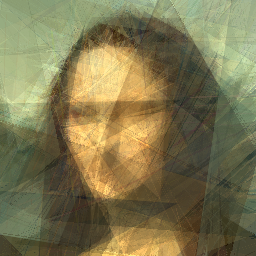

[2021-08-31 10:42:56.256340]   Iteration 1040, lr 0.03, loss 0.003638683585450053 loss (without noise) 0.003621112322434783


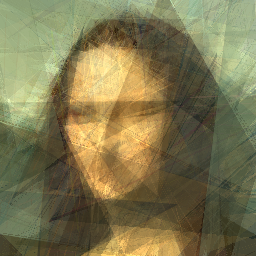

[2021-08-31 10:43:03.787205]   Iteration 1050, lr 0.03, loss 0.003611132502555847 loss (without noise) 0.0035967910662293434


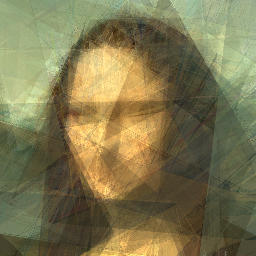

[2021-08-31 10:43:11.410509]   Iteration 1060, lr 0.03, loss 0.003597341477870941 loss (without noise) 0.0035837877076119184


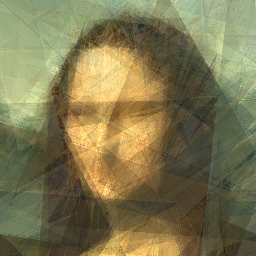

[2021-08-31 10:43:18.994144]   Iteration 1070, lr 0.03, loss 0.003614619141444564 loss (without noise) 0.003600630909204483


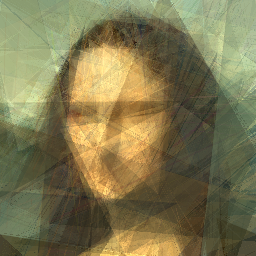

[2021-08-31 10:43:26.638050]   Iteration 1080, lr 0.03, loss 0.0036500096321105957 loss (without noise) 0.003636680543422699


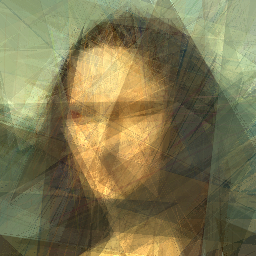

[2021-08-31 10:43:34.335366]   Iteration 1090, lr 0.03, loss 0.003653606865555048 loss (without noise) 0.0036396533250808716


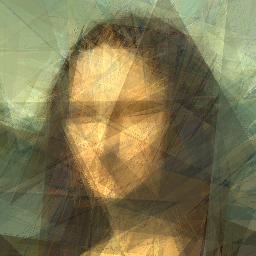

[2021-08-31 10:43:42.085256]   Iteration 1100, lr 0.03, loss 0.003635858651250601 loss (without noise) 0.003623169381171465


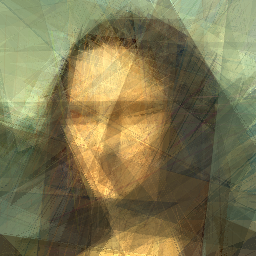

[2021-08-31 10:43:49.890124]   Iteration 1110, lr 0.03, loss 0.003655714448541403 loss (without noise) 0.0036427127197384834


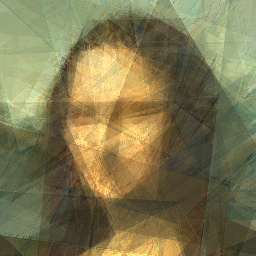

[2021-08-31 10:43:57.703952]   Iteration 1120, lr 0.03, loss 0.003619043854996562 loss (without noise) 0.0036066060420125723


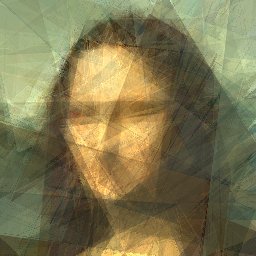

[2021-08-31 10:44:05.528270]   Iteration 1130, lr 0.03, loss 0.003577079391106963 loss (without noise) 0.003564540296792984


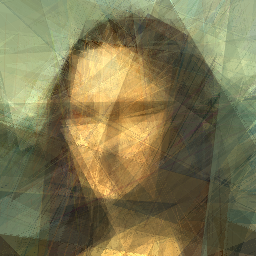

[2021-08-31 10:44:13.402333]   Iteration 1140, lr 0.03, loss 0.0035385615192353725 loss (without noise) 0.003527269698679447


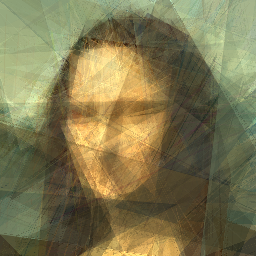

[2021-08-31 10:44:21.250870]   Iteration 1150, lr 0.03, loss 0.0035446647088974714 loss (without noise) 0.0035326904617249966


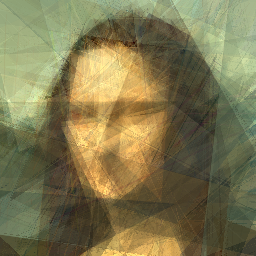

[2021-08-31 10:44:29.119621]   Iteration 1160, lr 0.03, loss 0.0035517048090696335 loss (without noise) 0.0035406709648668766


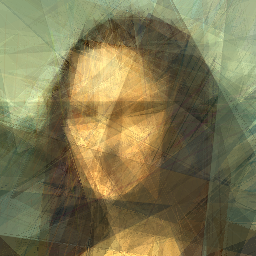

[2021-08-31 10:44:37.046132]   Iteration 1170, lr 0.03, loss 0.0035550366155803204 loss (without noise) 0.003542385995388031


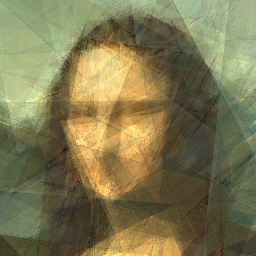

[2021-08-31 10:44:45.063148]   Iteration 1180, lr 0.03, loss 0.0035009030252695084 loss (without noise) 0.0034909085370600224


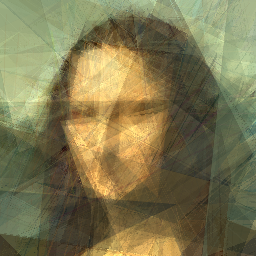

[2021-08-31 10:44:52.992169]   Iteration 1190, lr 0.03, loss 0.0034696205984801054 loss (without noise) 0.0034565029200166464


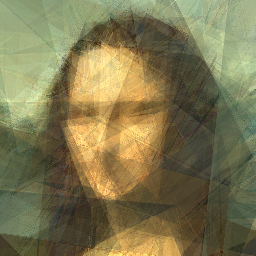

[2021-08-31 10:45:00.990678]   Iteration 1200, lr 0.03, loss 0.0034706543665379286 loss (without noise) 0.0034593725576996803


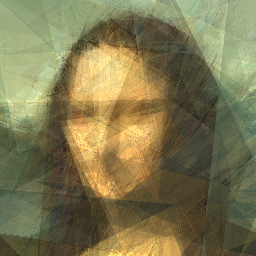

[2021-08-31 10:45:09.052554]   Iteration 1210, lr 0.03, loss 0.0034355116076767445 loss (without noise) 0.003423615824431181


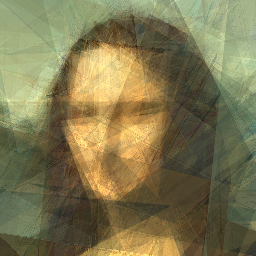

[2021-08-31 10:45:17.098046]   Iteration 1220, lr 0.03, loss 0.00341992499306798 loss (without noise) 0.003410590346902609


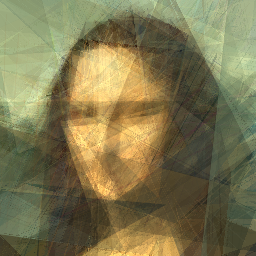

[2021-08-31 10:45:25.238726]   Iteration 1230, lr 0.03, loss 0.0034145163372159004 loss (without noise) 0.0034051798284053802


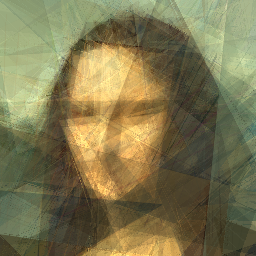

[2021-08-31 10:45:33.351973]   Iteration 1240, lr 0.03, loss 0.0034081998746842146 loss (without noise) 0.003398280590772629


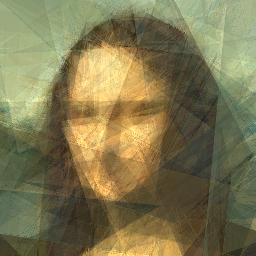

[2021-08-31 10:45:41.500285]   Iteration 1250, lr 0.03, loss 0.00344267999753356 loss (without noise) 0.0034316759556531906


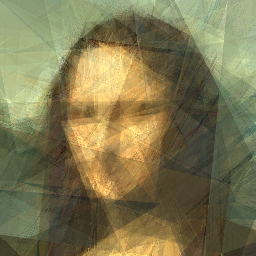

[2021-08-31 10:45:49.671316]   Iteration 1260, lr 0.03, loss 0.00342159578576684 loss (without noise) 0.003412579884752631


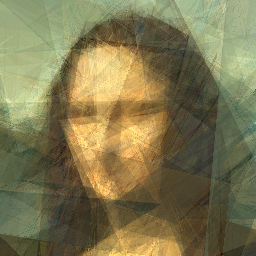

[2021-08-31 10:45:57.844147]   Iteration 1270, lr 0.03, loss 0.0033995674457401037 loss (without noise) 0.003389014396816492


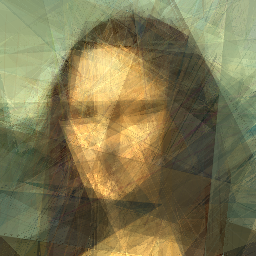

[2021-08-31 10:46:06.082390]   Iteration 1280, lr 0.03, loss 0.0033884458243846893 loss (without noise) 0.003379157744348049


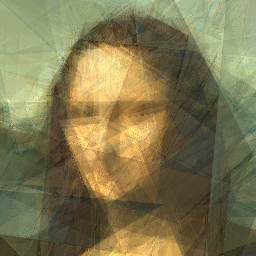

[2021-08-31 10:46:14.302890]   Iteration 1290, lr 0.03, loss 0.0034144381061196327 loss (without noise) 0.003405079711228609


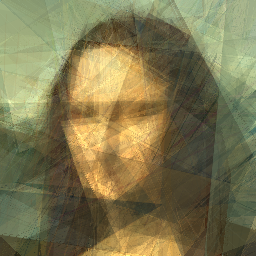

[2021-08-31 10:46:22.576240]   Iteration 1300, lr 0.03, loss 0.0033674822188913822 loss (without noise) 0.003358525224030018


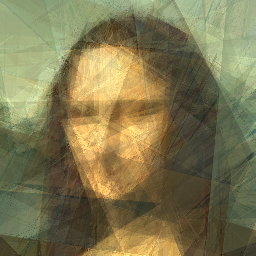

[2021-08-31 10:46:30.876949]   Iteration 1310, lr 0.03, loss 0.0033467537723481655 loss (without noise) 0.0033366642892360687


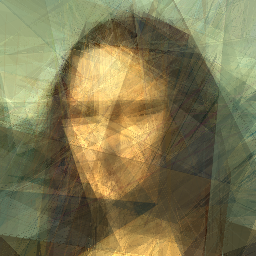

[2021-08-31 10:46:39.231321]   Iteration 1320, lr 0.03, loss 0.0033199996687471867 loss (without noise) 0.003310964908450842


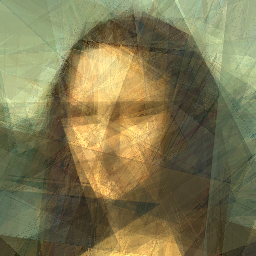

[2021-08-31 10:46:47.631275]   Iteration 1330, lr 0.03, loss 0.0033825680147856474 loss (without noise) 0.003374525811523199


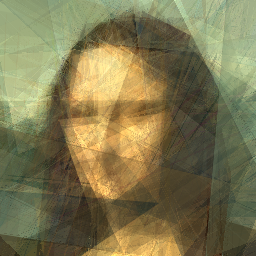

[2021-08-31 10:46:56.147944]   Iteration 1340, lr 0.03, loss 0.003358018584549427 loss (without noise) 0.0033497046679258347


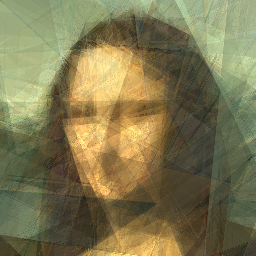

[2021-08-31 10:47:04.659276]   Iteration 1350, lr 0.03, loss 0.0033382861874997616 loss (without noise) 0.0033296956680715084


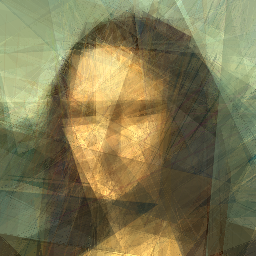

[2021-08-31 10:47:13.146505]   Iteration 1360, lr 0.03, loss 0.0033098342828452587 loss (without noise) 0.0033014107029885054


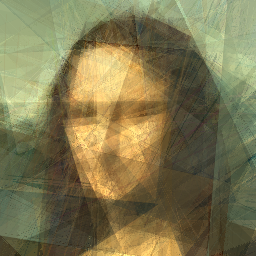

[2021-08-31 10:47:21.653381]   Iteration 1370, lr 0.03, loss 0.003320707008242607 loss (without noise) 0.0033126692287623882


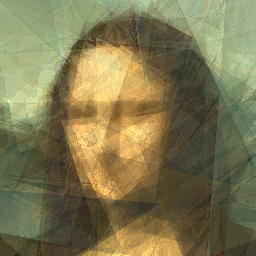

[2021-08-31 10:47:30.181874]   Iteration 1380, lr 0.03, loss 0.0033412552438676357 loss (without noise) 0.003334544599056244


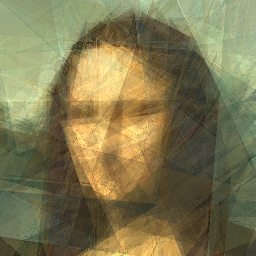

[2021-08-31 10:47:38.720784]   Iteration 1390, lr 0.03, loss 0.0033414065837860107 loss (without noise) 0.0033338170032948256


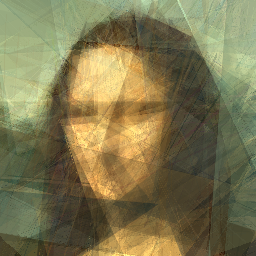

[2021-08-31 10:47:47.314265]   Iteration 1400, lr 0.03, loss 0.0033238837495446205 loss (without noise) 0.003316660178825259


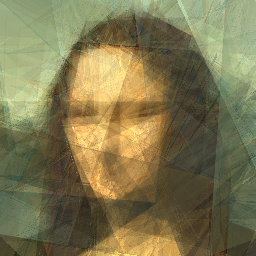

[2021-08-31 10:47:55.893928]   Iteration 1410, lr 0.03, loss 0.003301675897091627 loss (without noise) 0.0032932746689766645


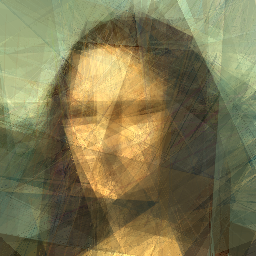

[2021-08-31 10:48:04.569113]   Iteration 1420, lr 0.03, loss 0.003273858455941081 loss (without noise) 0.0032662374433130026


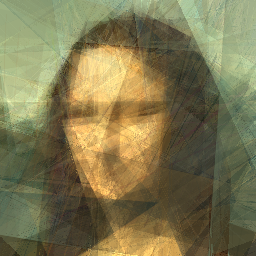

[2021-08-31 10:48:13.252964]   Iteration 1430, lr 0.03, loss 0.003227971028536558 loss (without noise) 0.00322006456553936


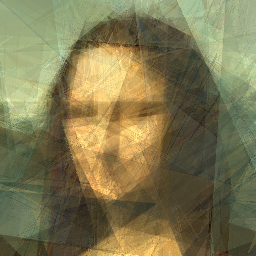

[2021-08-31 10:48:22.113978]   Iteration 1440, lr 0.03, loss 0.0032904515974223614 loss (without noise) 0.0032827588729560375


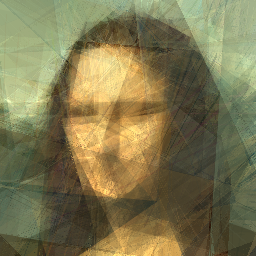

[2021-08-31 10:48:30.859407]   Iteration 1450, lr 0.03, loss 0.003286725841462612 loss (without noise) 0.0032789174001663923


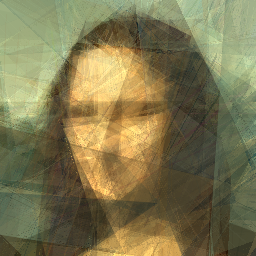

[2021-08-31 10:48:39.547643]   Iteration 1460, lr 0.03, loss 0.0032342150807380676 loss (without noise) 0.003226855769753456


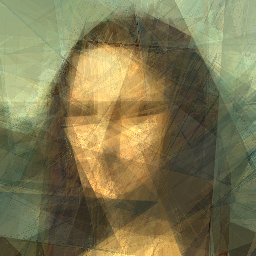

[2021-08-31 10:48:48.332637]   Iteration 1470, lr 0.03, loss 0.0032603461295366287 loss (without noise) 0.0032538173254579306


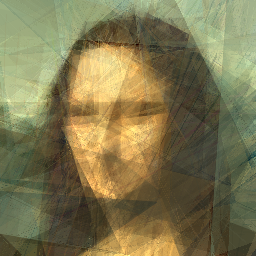

[2021-08-31 10:48:57.177222]   Iteration 1480, lr 0.03, loss 0.003256014548242092 loss (without noise) 0.003249300643801689


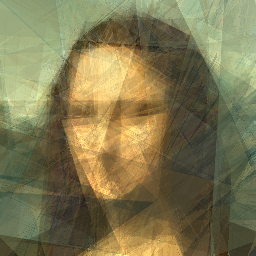

[2021-08-31 10:49:06.068585]   Iteration 1490, lr 0.03, loss 0.0032818985637277365 loss (without noise) 0.0032751380931586027


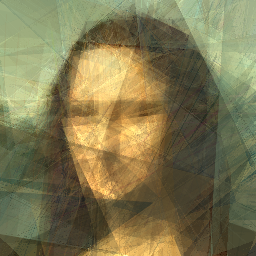

[2021-08-31 10:49:14.900949]   Iteration 1500, lr 0.03, loss 0.003231051843613386 loss (without noise) 0.0032244189642369747


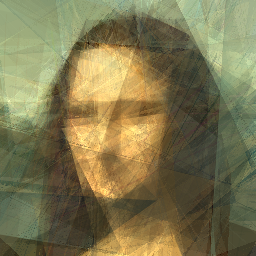

[2021-08-31 10:49:23.711590]   Iteration 1510, lr 0.029976023251634627, loss 0.0032316059805452824 loss (without noise) 0.0032248280476778746


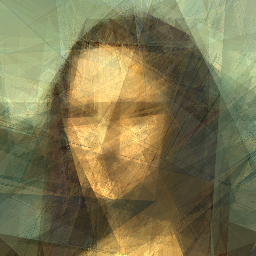

[2021-08-31 10:49:32.588450]   Iteration 1520, lr 0.0298932390685472, loss 0.003281156998127699 loss (without noise) 0.0032749741803854704


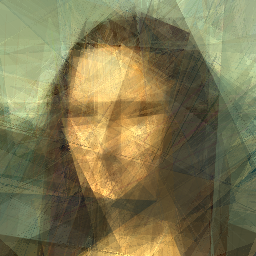

[2021-08-31 10:49:41.556302]   Iteration 1530, lr 0.029751678074929944, loss 0.0032569195609539747 loss (without noise) 0.003250187262892723


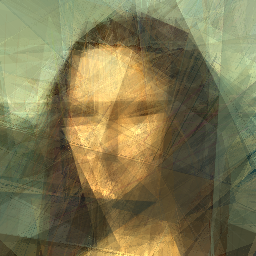

[2021-08-31 10:49:50.638858]   Iteration 1540, lr 0.029551898947351586, loss 0.003296768292784691 loss (without noise) 0.003290473949164152


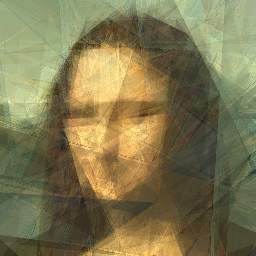

[2021-08-31 10:49:59.716223]   Iteration 1550, lr 0.029294690122758284, loss 0.00325514143332839 loss (without noise) 0.003249314147979021


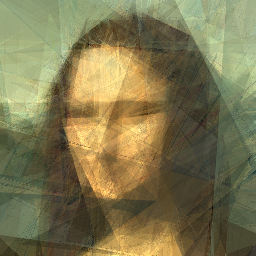

[2021-08-31 10:50:08.838764]   Iteration 1560, lr 0.028981066686873166, loss 0.0032983857672661543 loss (without noise) 0.0032933945767581463


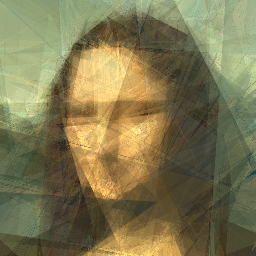

[2021-08-31 10:50:17.844510]   Iteration 1570, lr 0.028612266368116757, loss 0.0033059369307011366 loss (without noise) 0.0032995683141052723


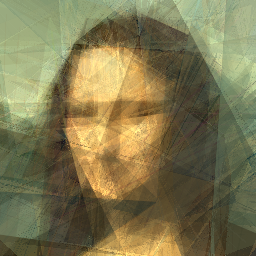

[2021-08-31 10:50:26.878654]   Iteration 1580, lr 0.028189744652858343, loss 0.00328519637696445 loss (without noise) 0.003279899014160037


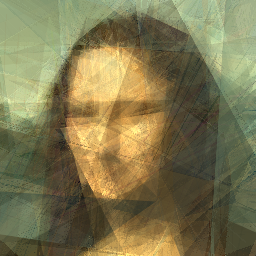

[2021-08-31 10:50:36.057675]   Iteration 1590, lr 0.027715169041276248, loss 0.0033104773610830307 loss (without noise) 0.0033049676567316055


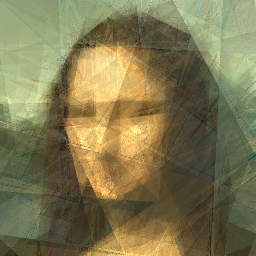

[2021-08-31 10:50:45.218054]   Iteration 1600, lr 0.027190412466496408, loss 0.0033393078483641148 loss (without noise) 0.0033327757846564054


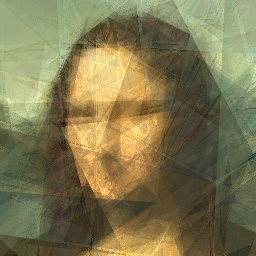

[2021-08-31 10:50:54.409393]   Iteration 1610, lr 0.026617545902981005, loss 0.003331355284899473 loss (without noise) 0.003325320780277252


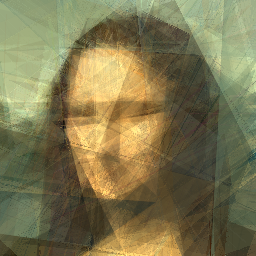

[2021-08-31 10:51:03.691464]   Iteration 1620, lr 0.025998830193338394, loss 0.0033770042937248945 loss (without noise) 0.0033719674684107304


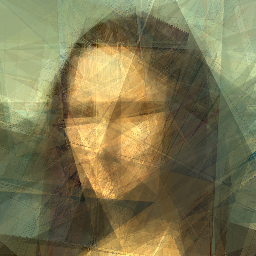

[2021-08-31 10:51:13.010596]   Iteration 1630, lr 0.025336707125810223, loss 0.0033987564966082573 loss (without noise) 0.003392608603462577


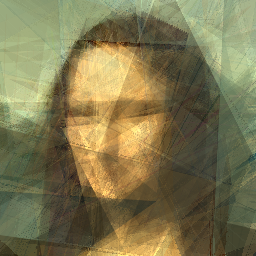

[2021-08-31 10:51:22.365321]   Iteration 1640, lr 0.024633789797648766, loss 0.003362638410180807 loss (without noise) 0.003357465146109462


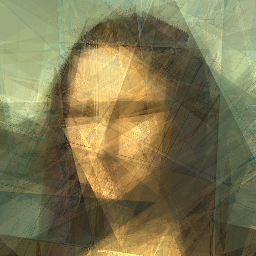

[2021-08-31 10:51:31.793830]   Iteration 1650, lr 0.02389285230241589, loss 0.0033954568207263947 loss (without noise) 0.003390737809240818


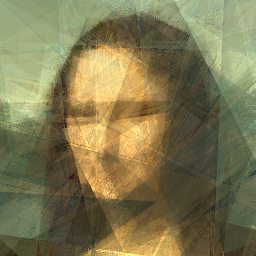

[2021-08-31 10:51:41.157830]   Iteration 1660, lr 0.023116818781903137, loss 0.003370379563421011 loss (without noise) 0.0033655231818556786


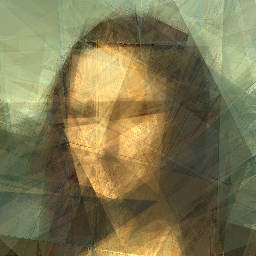

[2021-08-31 10:51:50.510473]   Iteration 1670, lr 0.022308751885879982, loss 0.0033959930296987295 loss (without noise) 0.0033913333900272846


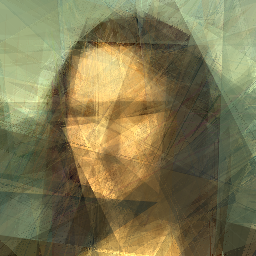

[2021-08-31 10:51:59.904587]   Iteration 1680, lr 0.021471840685214377, loss 0.003426745068281889 loss (without noise) 0.0034222439862787724


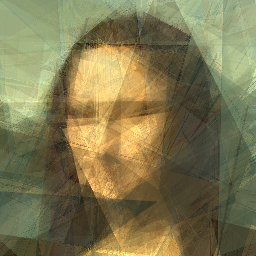

[2021-08-31 10:52:09.409420]   Iteration 1690, lr 0.020609388086067, loss 0.003426907118409872 loss (without noise) 0.0034227247815579176


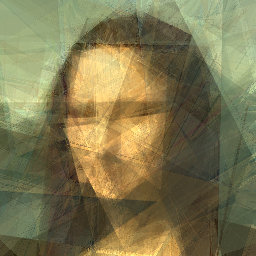

[2021-08-31 10:52:18.995493]   Iteration 1700, lr 0.019724797794829566, loss 0.0034272584598511457 loss (without noise) 0.0034230025485157967


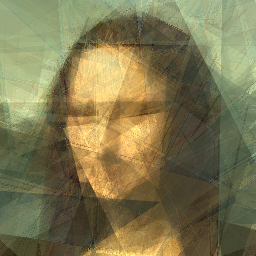

[2021-08-31 10:52:28.535708]   Iteration 1710, lr 0.01882156088525072, loss 0.00357269961386919 loss (without noise) 0.0035686239134520292


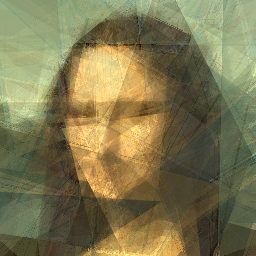

[2021-08-31 10:52:38.114049]   Iteration 1720, lr 0.017903242020762895, loss 0.003503908170387149 loss (without noise) 0.0034988578408956528


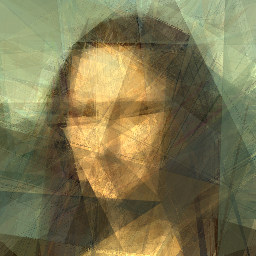

[2021-08-31 10:52:47.685918]   Iteration 1730, lr 0.016973465386384223, loss 0.003490986069664359 loss (without noise) 0.003485917579382658


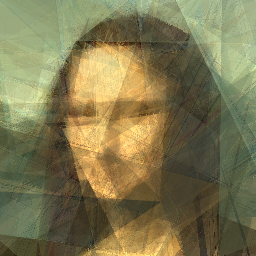

[2021-08-31 10:52:57.269435]   Iteration 1740, lr 0.016035900385716072, loss 0.0034604358952492476 loss (without noise) 0.0034562915097922087


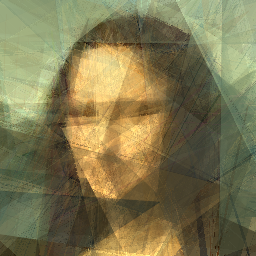

[2021-08-31 10:53:07.002862]   Iteration 1750, lr 0.015094247159483373, loss 0.0034693225752562284 loss (without noise) 0.0034648743458092213


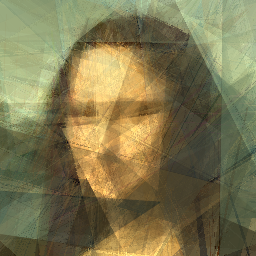

[2021-08-31 10:53:16.665995]   Iteration 1760, lr 0.014152221982769641, loss 0.003490037051960826 loss (without noise) 0.0034855231642723083


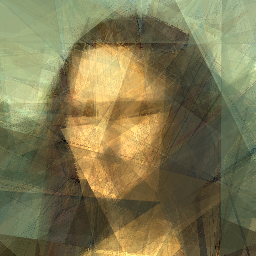

[2021-08-31 10:53:26.317077]   Iteration 1770, lr 0.01321354259857696, loss 0.0035325619392096996 loss (without noise) 0.0035275823902338743


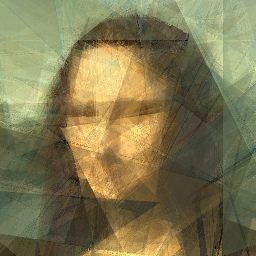

[2021-08-31 10:53:36.188625]   Iteration 1780, lr 0.012281913545592946, loss 0.003477365244179964 loss (without noise) 0.003473508870229125


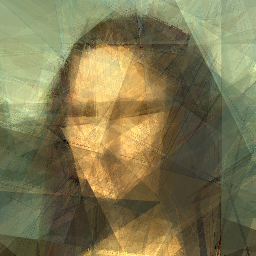

[2021-08-31 10:53:45.938250]   Iteration 1790, lr 0.011361011538068896, loss 0.003441892098635435 loss (without noise) 0.003437321400269866


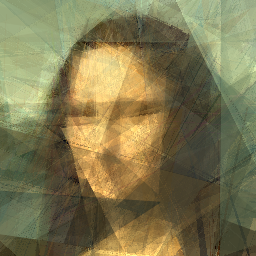

[2021-08-31 10:53:55.771914]   Iteration 1800, lr 0.010454470955508395, loss 0.003445701440796256 loss (without noise) 0.0034408699721097946


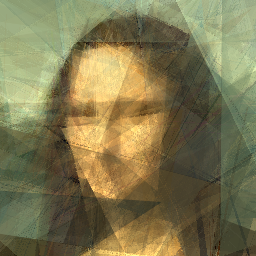

[2021-08-31 10:54:05.654693]   Iteration 1810, lr 0.00956586949943182, loss 0.003435869235545397 loss (without noise) 0.003431719494983554


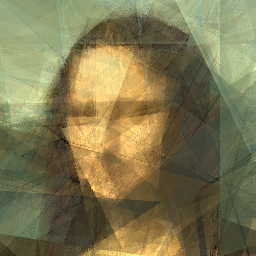

[2021-08-31 10:54:15.624006]   Iteration 1820, lr 0.00869871407382291, loss 0.0034315509255975485 loss (without noise) 0.0034271059557795525


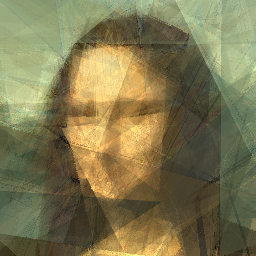

[2021-08-31 10:54:25.566140]   Iteration 1830, lr 0.007856426944980916, loss 0.003420520108193159 loss (without noise) 0.003416601102799177


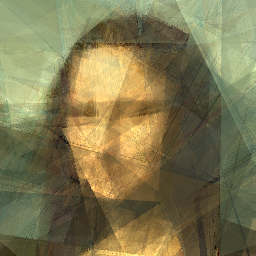

[2021-08-31 10:54:35.567122]   Iteration 1840, lr 0.00704233223539899, loss 0.0034058531746268272 loss (without noise) 0.0034022675827145576


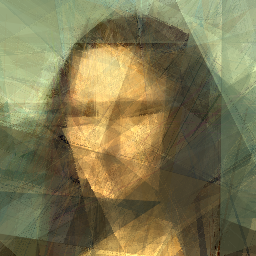

[2021-08-31 10:54:45.499019]   Iteration 1850, lr 0.00625964280497136, loss 0.003404029179364443 loss (without noise) 0.003398960456252098


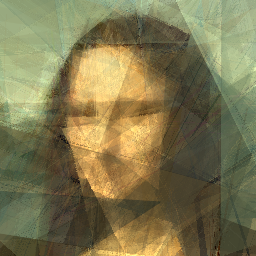

[2021-08-31 10:54:55.493371]   Iteration 1860, lr 0.005511447571303133, loss 0.003386580152437091 loss (without noise) 0.0033832702320069075


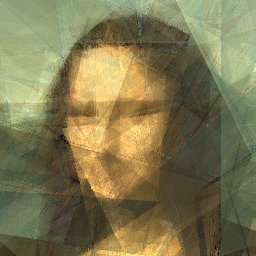

[2021-08-31 10:55:05.463533]   Iteration 1870, lr 0.004800699319163711, loss 0.003382018767297268 loss (without noise) 0.0033776620402932167


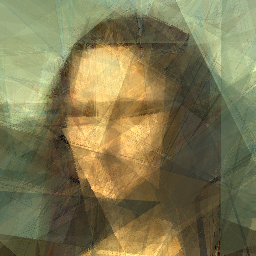

[2021-08-31 10:55:15.565536]   Iteration 1880, lr 0.0041302030471942995, loss 0.003380439942702651 loss (without noise) 0.0033761735539883375


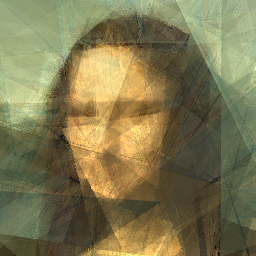

[2021-08-31 10:55:25.582360]   Iteration 1890, lr 0.0035026048978597504, loss 0.0033788634464144707 loss (without noise) 0.0033742785453796387


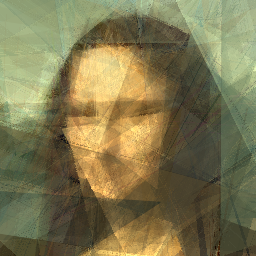

[2021-08-31 10:55:35.652805]   Iteration 1900, lr 0.0029203817143331682, loss 0.003372556995600462 loss (without noise) 0.003368491306900978


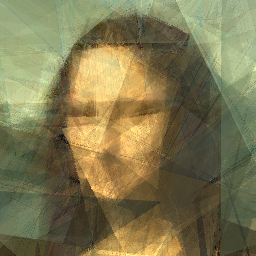

[2021-08-31 10:55:45.822495]   Iteration 1910, lr 0.0023858312655274626, loss 0.0033715846948325634 loss (without noise) 0.003367811441421509


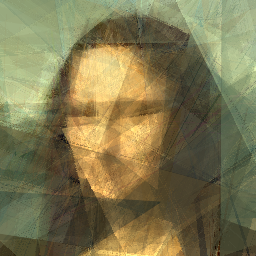

[2021-08-31 10:55:55.943304]   Iteration 1920, lr 0.001901063177851196, loss 0.003367285942658782 loss (without noise) 0.0033637124579399824


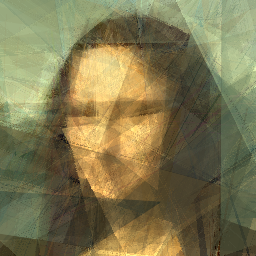

[2021-08-31 10:56:06.229176]   Iteration 1930, lr 0.0014679906094769556, loss 0.0033649259712547064 loss (without noise) 0.003361032111570239


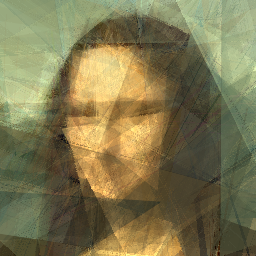

[2021-08-31 10:56:16.570700]   Iteration 1940, lr 0.0010883226999800777, loss 0.0033642458729445934 loss (without noise) 0.00336059695109725


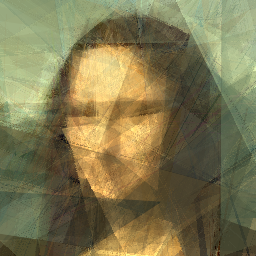

[2021-08-31 10:56:26.945879]   Iteration 1950, lr 0.0007635578251455794, loss 0.0033635057043284178 loss (without noise) 0.003359319409355521


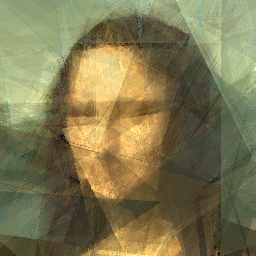

[2021-08-31 10:56:37.635301]   Iteration 1960, lr 0.0004949776835634717, loss 0.0033626174554228783 loss (without noise) 0.003358740359544754


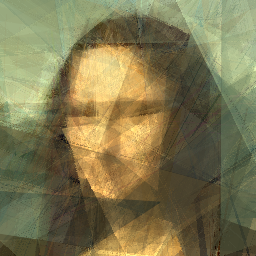

[2021-08-31 10:56:47.992481]   Iteration 1970, lr 0.000283642238349987, loss 0.003362303599715233 loss (without noise) 0.003358831163495779


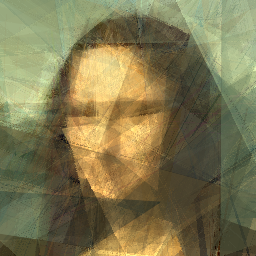

[2021-08-31 10:56:58.376934]   Iteration 1980, lr 0.00013038553395740114, loss 0.003362371353432536 loss (without noise) 0.0033583356998860836


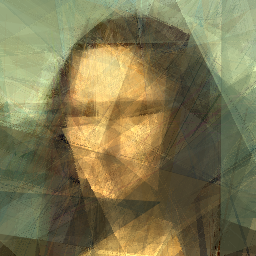

[2021-08-31 10:57:08.918460]   Iteration 1990, lr 3.5812404581621604e-05, loss 0.0033623110502958298 loss (without noise) 0.0033580358140170574


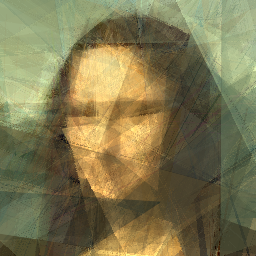

[2021-08-31 10:57:19.599244]   Iteration 2000, lr 2.9608715794327e-07, loss 0.00336260162293911 loss (without noise) 0.0033579892478883266


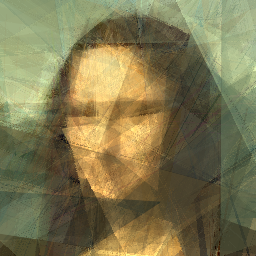

In [13]:
save_dir = 'triangles_nvdiffrast_v2_out'
os.makedirs(save_dir, exist_ok=True)
pil_img_list = []
info_list = []

for i in range(n_iterations):
    lr = ors.get_lr_scale(i) * base_lr
    optim.param_groups[0]['lr'] = lr
    noise_scale = (0.05 * ors.get_noise_scale(i))
    verts_noise = torch.randn_like(verts) * noise_scale
    color_noise = torch.randn_like(color) * noise_scale * 0.5
    verts_in = verts + verts_noise
    color_in = color + color_noise
    out = render(verts, color_in, {'bg_noise': 0.05})
    loss = ((out-target)**2).mean()
    optim.zero_grad()
    loss.backward()
    if (i + 1) % report_iterations == 0:
        
        with torch.no_grad():
            verts_in = verts
            color_in = color
            out = render(verts, color_in, {'bg_noise': 0.0})
            wonoise_loss = ((out-target)**2).mean()

        info = f"[{datetime.now()}]   Iteration {i + 1}, lr {optim.param_groups[0]['lr']}, loss {loss.item()} loss (without noise) {wonoise_loss.item()}"
        print(info)
        info_list.append(info)
        save_info_list(f'{save_dir}/log.txt', info_list)
            
        show(out)
        pil_img_list.append(to_pil_img(out))
        save_as_gif(f'{save_dir}/animate.gif', pil_img_list, fps=12)
        save_as_frames(f'{save_dir}/animate.frames', pil_img_list)
        
    optim.step()